# Predicting Popularity and Importance of Artwork in the Met's Collection 
In this project, I have predicted the popularity and importance of artwork in the collection of the Metropolitan Museum of Art, also known as The Met. The museum keeps a list of Highlights, which are selected works of art from The Met’s permanent collection that are considered popular and important. These are less than 1% of all artworks in their collection.

To find items closest to the Highlighted artworks, I created a classifier that finds Highlighted items with high precision, and then picked the top k highest scoring non-Highlighted items. Hopefully these are artworks that should have been Highlighted, but have somehow ‘slipped through the cracks’. In the image below, I’m creating a classifier, scoring, sorting by score and picking the highest scoring non-Highlighted items.

We have a needle in a haystack type problem, where the classes are heavily imbalanced, and we are only interested in precision at the very top of our list. Precision@k is the metric most suited for our problem, where we pick the k highest scoring items and measure the precision. For each model I have selected a different threshold that would result in exactly 100 positives, allowing me to compare them using Precision@k, where k is 100.

This type of modeling can be used by The Met to identify objects in their collection that they might consider reclassifying as important or for classifying new additions to the collection. At the end of this notebook I present the top 10 highest scoring non-highlighted objects.

![Methodology](methodology.png)

In [1]:
# Imports necessary libraries
import numpy as np
import pandas as pd
from matplotlib import pyplot
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.metrics import roc_curve
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn import metrics
from sklearn import model_selection
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neural_network import MLPClassifier
from sklearn import preprocessing
from matplotlib.colors import LogNorm
import requests
import IPython.display as Disp

### GoogleSQL query used to generate the .csv file
``` mysql
SELECT
  object_id,
  artist_display_name AS artist_name,
  title, city, country, 
  department,
  culture,
  is_public_domain,
  medium,
  classification,
  dimensions,
  period,
  SAFE_CAST(object_date AS INT64) AS object_date,
  link_resource AS url,
  SAFE_CAST(artist_begin_date AS INT64) AS year_artist_was_born,
  CASE 
    WHEN SAFE_CAST(artist_begin_date AS INT64)>=1900 THEN "20th century"
    WHEN SAFE_CAST(artist_begin_date AS INT64)>=1800 THEN "19th century"
    WHEN SAFE_CAST(artist_begin_date AS INT64)>=1700 THEN "18th century" 
    WHEN SAFE_CAST(artist_begin_date AS INT64)>=1600 THEN "17th century" 
    WHEN SAFE_CAST(artist_begin_date AS INT64)<1600 THEN "before 17th century"
    ELSE NULL
  END AS artist_century, 
  SAFE_CAST(artist_end_date AS INT64) AS year_artist_died 
FROM 
  `bigquery-public-data.the_met.objects` 
WHERE
  object_id IS NOT NULL
  AND artist_display_name IS NOT NULL
  AND title IS NOT NULL
  AND department IS NOT NULL
  AND is_public_domain IS NOT NULL;
```

In [2]:
# Loads the saved dataset
df = pd.read_csv("the_MET_dataset.csv")

In [3]:
# Prints the dataframe summary
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81636 entries, 0 to 81635
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   object_id             81636 non-null  int64  
 1   artist_name           81636 non-null  object 
 2   title                 81636 non-null  object 
 3   city                  6172 non-null   object 
 4   country               5938 non-null   object 
 5   department            81636 non-null  object 
 6   culture               21589 non-null  object 
 7   is_public_domain      81636 non-null  bool   
 8   medium                81190 non-null  object 
 9   classification        80480 non-null  object 
 10  dimensions            77350 non-null  object 
 11  period                3321 non-null   object 
 12  object_date           23084 non-null  float64
 13  url                   81636 non-null  object 
 14  year_artist_was_born  54919 non-null  float64
 15  artist_century     

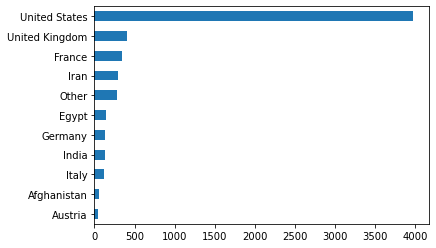

In [4]:
# If multiple values are present, splits the string and selects the first value
df["country"] = df["country"].str.split("|").str[0]
# Removes the phrase 'present-day', e.g. 'present-day Afghanistan' -> 'Afghanistan'
df["country"] = df["country"].str.replace("present-day","").str.strip()
# Replaces England with United Kingdom
df["country"].replace("England", "United Kingdom", inplace=True)
# Replaces values that are not in the most frequent 10 list with 'Other'
frequent_countries = df["country"].value_counts()
frequent_countries = frequent_countries.head(10).index.tolist()
df.loc[(~df["country"].isin(frequent_countries)) & (~df["country"].isnull()), "country"] = "Other"
# Plots the value counts for unique values
df["country"].value_counts().sort_values(ascending=True).plot(kind="barh");

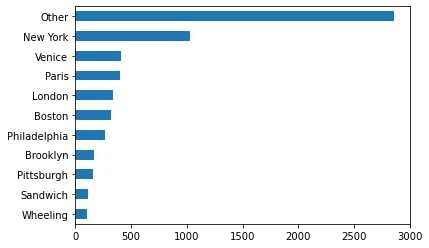

In [5]:
# If multiple values are present, splits the string and selects the first value
df["city"] = df["city"].str.split("|").str[0]
# Removes the phrase 'probably'
df["city"] = df["city"].str.replace("probably","").str.strip()
# Replaces values that are not in the most frequent 10 list with 'Other'
frequent_cities = df["city"].value_counts()
frequent_cities = frequent_cities.head(10).index.tolist()
df.loc[(~df["city"].isin(frequent_cities)) & (~df["city"].isnull()), "city"] = "Other"
# Plots the value counts for unique values
df["city"].value_counts().sort_values(ascending=True).plot(kind="barh");

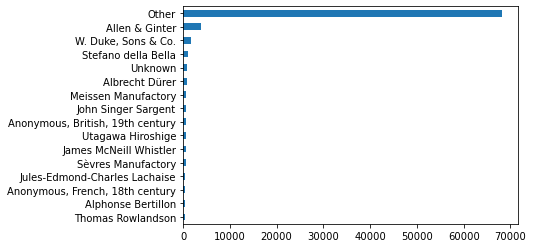

In [6]:
# If multiple values are present, splits the string and selects the first value
df["artist_name"] = df["artist_name"].str.split("|").str[0]
# Replaces values that are not in the most frequent 15 list with 'Other'
frequent_artists = df["artist_name"].value_counts()
frequent_artists = frequent_artists.head(15).index.tolist()
df.loc[(~df["artist_name"].isin(frequent_artists)) & (~df["artist_name"].isnull()), "artist_name"] = "Other"
# Plots the value counts for unique values
df["artist_name"].value_counts().sort_values(ascending=True).plot(kind="barh");

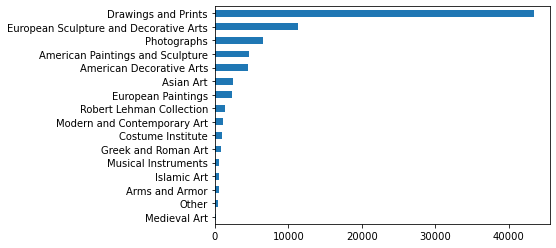

In [7]:
# Replaces values that are not in the most frequent 15 list with 'Other'
frequent_departments = df["department"].value_counts()
frequent_departments = frequent_departments.head(15).index.tolist()
df.loc[(~df["department"].isin(frequent_departments)) & (~df["department"].isnull()), "department"] = "Other"
# Plots the value counts for unique values
df["department"].value_counts().sort_values(ascending=True).plot(kind="barh");

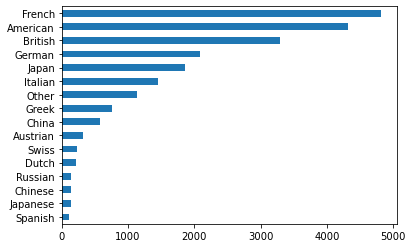

In [8]:
# If multiple values are present, splits the string and selects the first value
df["culture"] = df["culture"].str.split(",").str[0]
# Removes the phrase 'probably'
df["culture"] = df["culture"].str.replace("probably","").str.strip()
# Replaces certain values
df["culture"].replace({"South Netherlandish": "Netherlandish",
                       "British (American market)": "British",
                       "Korea": "Korean"}, inplace=True)
# Replaces values that are not in the most frequent 15 list with 'Other'
frequent_culture = df["culture"].value_counts()
frequent_culture = frequent_culture.head(15).index.tolist()
df.loc[(~df["culture"].isin(frequent_culture)) & (~df["culture"].isnull()), "culture"] = "Other"
# Plots the value counts for unique values
df["culture"].value_counts().sort_values(ascending=True).plot(kind="barh");

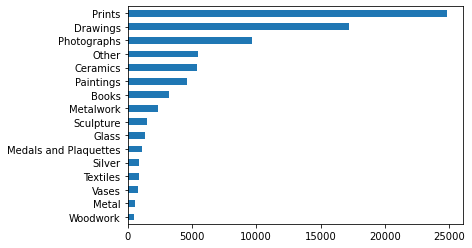

In [9]:
# If multiple values are present, splits the string and selects the first value
df["classification"] = df["classification"].str.split("|").str[0]
# Replaces certain values
df["classification"].replace({"Illustrated Books": "Books",
                              "Ceramics-Porcelain": "Ceramics",
                              "Ceramics-Pottery": "Ceramics",
                              "Textiles-Printed": "Textiles",
                              "Textiles-Tapestries": "Textiles",
                              "Textiles-Woven": "Textiles",
                              "Sculpture-Miniature": "Sculpture",
                              "Sculpture-Bronze": "Sculpture",
                              "Glass-Stained": "Glass",
                              "Woodwork-Furniture": "Woodwork",
                              "Metalwork-Silver": "Metalwork",
                              "Metalwork-Silver-Miniature": "Metalwork",
                              "Works on Paper-Drawings": "Drawings",
                              "Metalwork-Silver In Combination": "Metalwork",
                              "Metalwork-Gold and Platinum": "Metalwork",
                              "Metalwork-Pewter": "Metalwork"}, inplace=True)
# Replaces values that are not in the most frequent 15 list with 'Other'
frequent_class = df["classification"].value_counts()
frequent_class = frequent_class.head(15).index.tolist()
df.loc[(~df["classification"].isin(frequent_class)) & (~df["classification"].isnull()), "classification"] = "Other"
# Removes the leading and trailing spaces
df["classification"] = df["classification"].str.strip()
# Plots the value counts for unique values
df["classification"].value_counts().sort_values(ascending=True).plot(kind="barh");

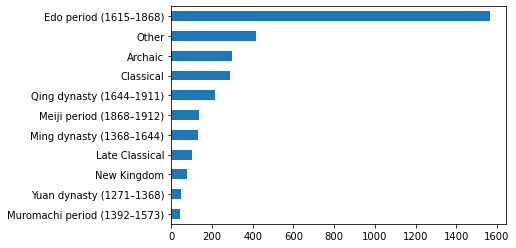

In [10]:
# Replaces values that are not in the most frequent 10 list with 'Other'
frequent_period = df["period"].value_counts()
frequent_period = frequent_period.head(10).index.tolist()
df.loc[(~df["period"].isin(frequent_period)) & (~df["period"].isnull()), "period"] = "Other"
# Plots the value counts for unique values
df["period"].value_counts().sort_values(ascending=True).plot(kind="barh");

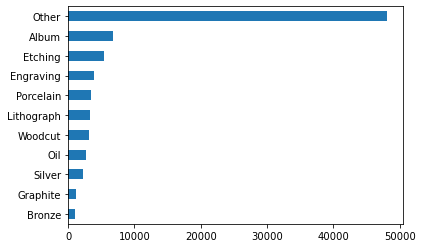

In [11]:
# Replaces certain values
df["medium"].replace({"Commercial color lithograph": "Lithograph",
                      "Etching and engraving": "Etching",
                      "Hard-paste porcelain": "Porcelain",
                      "Soft-paste porcelain": "Porcelain",
                      "Albumen silver print from glass negative": "Album",
                      "Albumen photograph": "Album",
                      "Albumen silver print": "Album",
                      "Graphite on off-white wove paper": "Graphite",
                      "Oil on canvas": "Oil",
                      "Oil on wood": "Oil"}, inplace=True)
# Replaces values that are not in the most frequent 10 list with 'Other'
frequent_medium = df["medium"].value_counts()
frequent_medium = frequent_medium.head(10).index.tolist()
df.loc[(~df["medium"].isin(frequent_medium)) & (~df["medium"].isnull()), "medium"] = "Other"
# Plots the value counts for unique values
df["medium"].value_counts().sort_values(ascending=True).plot(kind="barh");

In [12]:
def extract_dims(s):
    """
    Extracts dimensions from the Dimensions column
  
        Args:
            s (str): Description of the dimensions

        Returns:
            list: Area and Volume
    """
    dims = [np.nan, np.nan] 
    s = str(s) 
    s = s.replace("(", "").replace(")","")
    splt = s.split(" ")
    if "cm" not in splt:
        return dims
    cm_idx = splt.index("cm")
    three_d = False

    if cm_idx - 4 >= 0 and splt[cm_idx - 4] in ["×","x"]:
        three_d = True

    if three_d == True:
        elems = [splt[cm_idx-5], splt[cm_idx-3], splt[cm_idx-1]]
    else:
        elems = [splt[cm_idx-3], splt[cm_idx-1]]

    try:
        dim = np.prod([eval(x) for x in elems])
    except:
        return dims

    if three_d == False:
        dims[0] = dim
    else:
        dims[1] = dim

    return dims

# Creates a Dataframe with Area, Volume and 2d/3d indicators
dims_df = df[["dimensions"]].apply(extract_dims, axis=1, result_type="expand")
dims_df.columns = ["area", "volume"]
dims_df["2d"] = ~dims_df["area"].isnull()
dims_df["3d"] = ~dims_df["volume"].isnull()

In [13]:
# Prints the number of unique values per column
df.nunique()

object_id               81636
artist_name                16
title                   59822
city                       11
country                    11
department                 16
culture                    16
is_public_domain            1
medium                     11
classification             16
dimensions              54703
period                     11
object_date               506
url                     81636
year_artist_was_born      696
artist_century              5
year_artist_died          700
is_highlight                2
dtype: int64

In [14]:
# Creates a backup copy of the dataframe
df_old = df
# Removes columns that will not be used for Machine Learning
df = df_old[["object_id","object_date","is_public_domain","year_artist_was_born","year_artist_died","is_highlight"]]

In [15]:
# Converts the categorical variables to dummy/indicator variables and appends to the dataframe
df = pd.concat([pd.get_dummies(df_old["artist_name"], prefix="artist_name"), df], axis=1)
df = pd.concat([pd.get_dummies(df_old["artist_century"], prefix="artist_century"), df], axis=1)
df = pd.concat([pd.get_dummies(df_old["country"], prefix="country"), df], axis=1)
df = pd.concat([pd.get_dummies(df_old["city"], prefix="city"), df], axis=1)
df = pd.concat([pd.get_dummies(df_old["culture"], prefix="culture"), df], axis=1)
df = pd.concat([pd.get_dummies(df_old["classification"], prefix="classification"), df], axis=1)
df = pd.concat([pd.get_dummies(df_old["medium"], prefix="medium"), df], axis=1)
df = pd.concat([pd.get_dummies(df_old["period"], prefix="period"), df], axis=1)
df = pd.concat([pd.get_dummies(df_old["department"], prefix="department"), df], axis=1)
df = pd.concat([dims_df, df], axis=1)

# Creates a feature representing the length of the title
df["title_length"] = df_old["title"].str.len()
# Creates a feature representing the number of words in the title
df["title_num_words"] = df_old["title"].str.count(' ').add(1)

# Makes object_id the first column
col = df.pop("object_id")
df.insert(0, col.name, col)
# Makes is_highlight the last column
col = df.pop("is_highlight")
df.insert(df.shape[1], col.name, col)

In [16]:
# Creates the X by removing the id column and the target variable (is_highlight)
X = df.iloc[:, 1:-1]
# Creates the Y
y = df.iloc[:, -1]

# Splits X and Y into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=1)

In [17]:
# Creates an imputer using mean
imp_mean = SimpleImputer(missing_values=np.nan, strategy="mean")
imp_mean.fit(X_train)

# Imputes missing values in the training and test sets
X_train = imp_mean.transform(X_train)
X_test = imp_mean.transform(X_test)

In [18]:
# Creates a scaler
scaler = preprocessing.StandardScaler().fit(X_train)

In [19]:
def precision_at_k(y, y_hat, model_name, k):
    """
    Prints the confusion matrix, ROC curve and Precision@k value
  
        Args:
            y (numpy.array): True y
            y_hat (numpy.array): Predicted y (probability)
            model_name (str): Model name
            k (int): k from Precision@k

        Returns:
            None
    """
    # Generates FPR and TPR for the ROC curve
    fpr, tpr, _ = metrics.roc_curve(y, y_hat)
    
    # Creates a binary numpy array that contains k positive predictions
    sorting_idx = y_hat.argsort()
    y_hat = y_hat[sorting_idx[::-1]]
    y = y[sorting_idx[::-1]]
    y_hat_binary = [1] * k + [0] * (len(y_hat)-k)
    
    # Creates and plots the confusion matrix
    cf_matrix = metrics.confusion_matrix(y, y_hat_binary)
    group_names = ["True Neg","False Pos","False Neg","True Pos"]
    group_counts = ["{0:0.0f}".format(value) for value in
                    cf_matrix.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in
                         cf_matrix.flatten()/np.sum(cf_matrix)]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(cf_matrix, norm=LogNorm(cf_matrix.min(),cf_matrix.max()), annot=labels, fmt="", cmap="Blues")
    pyplot.show()
    
    # Calculates the False Positive Rate, True Positive Rate and Positive Predictive Value
    k_fpr = cf_matrix[0,1] / (cf_matrix[0,1] + cf_matrix[0,0])
    k_tpr = cf_matrix[1,1] / (cf_matrix[1,1] + cf_matrix[1,0])
    k_ppv = cf_matrix[1,1] / (cf_matrix[1,1] + cf_matrix[0,1])
    
    # Plots the ROC curve
    pyplot.plot(fpr, tpr, marker=".", label=model_name, zorder=0)
    pyplot.scatter(k_fpr, k_tpr, marker="o", color="black", label="Threshold for k = " + str(k) + " positives", zorder=1)
    pyplot.plot([0,1], [0,1], linestyle="--", label="No Skill", zorder=2)
    pyplot.xlabel("False Positive Rate")
    pyplot.ylabel("True Positive Rate")
    pyplot.legend()
    pyplot.show()
    
    # Prints the Precision@k
    print("Precision at k = " + str(k) + " is " + str(k_ppv))
    return

In [20]:
# Converts y_test to a numpy array
y_test_np = np.array(y_test.tolist())
# Sets the k value to 100 (for Precision@k calculation)
k = 100

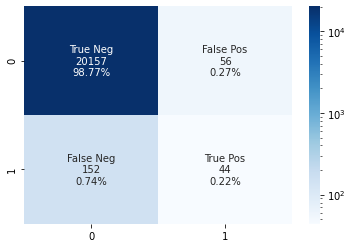

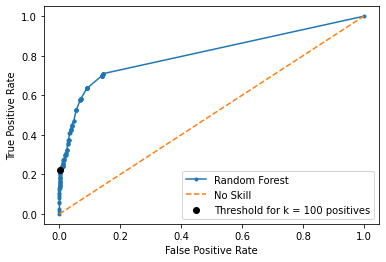

Precision at k = 100 is 0.44


In [21]:
# Random Forest
clf = RandomForestClassifier(n_estimators=100)
clf.fit(X_train, y_train)
y_test_pred = clf.predict_proba(X_test)[:,1]
precision_at_k(y=y_test_np, y_hat=y_test_pred, model_name="Random Forest", k=k)

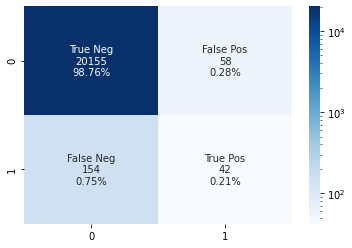

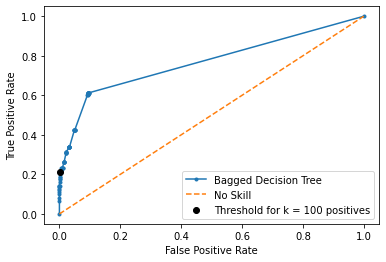

Precision at k = 100 is 0.42


In [22]:
# Bagged Decision Tree
clf = BaggingClassifier(DecisionTreeClassifier(), max_samples=0.5, max_features=1.0, n_estimators=25)
clf.fit(X_train, y_train)
y_test_pred = clf.predict_proba(X_test)[:,1]
precision_at_k(y=y_test_np, y_hat=y_test_pred, model_name="Bagged Decision Tree", k=k)

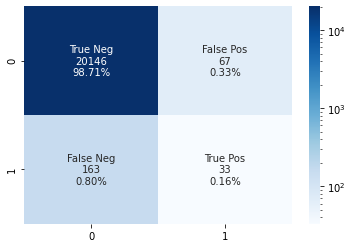

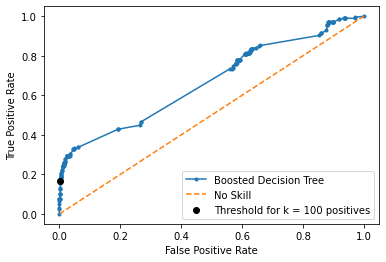

Precision at k = 100 is 0.33


In [23]:
# Boosted Decision Tree
clf = AdaBoostClassifier(DecisionTreeClassifier(), n_estimators=10, learning_rate=1)
clf.fit(X_train, y_train)
y_test_pred = clf.predict_proba(X_test)[:,1]
precision_at_k(y=y_test_np, y_hat=y_test_pred, model_name="Boosted Decision Tree", k=k)

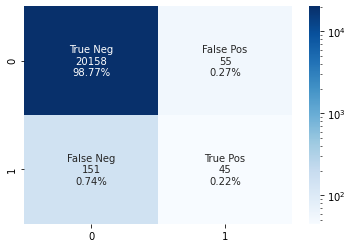

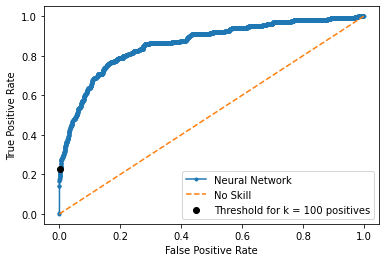

Precision at k = 100 is 0.45


In [24]:
# Neural Network
clf = MLPClassifier(random_state=1, max_iter=300, activation="relu", solver="adam")
clf.fit(scaler.transform(X_train), y_train)
y_test_pred = clf.predict_proba(scaler.transform(X_test))[:,1]
precision_at_k(y=y_test_np, y_hat=y_test_pred, model_name="Neural Network", k=k)

In [25]:
# Retrains the Neural Network on the entire dataset
clf = MLPClassifier(random_state=1, max_iter=300, activation="relu", solver="adam")
X_imp_scaled = scaler.transform(imp_mean.transform(X))
clf.fit(X_imp_scaled, y)
y_test_pred = clf.predict_proba(X_imp_scaled)[:,1]

# Selects top 10 highest scoring non-highlighted objects
df_pred = pd.concat([df["object_id"], y, pd.Series(y_test_pred)], axis=1)
df_pred.rename(columns={0:"prediction"}, inplace=True)
df_pred = df_pred.sort_values("prediction", ascending=False)
df_pred = df_pred[~df_pred["is_highlight"]]
objects = df_pred.head(10)["object_id"].tolist()

In [26]:
# Creates a list to store Disp objects for printing
imgs = []
# For each object in the Top 10 list
for obj in objects:
    # Generates a url for the object
    url = "https://collectionapi.metmuseum.org/public/collection/v1/objects/" + str(obj)
    # Downloads the page
    response = requests.get(url)
    # Converts the downloaded page to json
    json_data = response.json()
    # Appends the title of the object and the artist's name
    imgs.append(Disp.Markdown(json_data["title"] + " by " + json_data["artistDisplayName"] + ", " + json_data["objectDate"] + ":"))
    # Appends the image (if exists)
    if json_data["primaryImage"] != "":
        imgs.append(Disp.Image(requests.get(json_data["primaryImage"]).content, height=200, width=200))
    else:
        imgs.append(Disp.Image(requests.get("https://i.ebayimg.com/images/g/M4EAAOSwglZfvt0h/s-l300.png").content, height=200, width=200))

The Prayer Book of Bonne of Luxembourg, Duchess of Normandy by Jean Le Noir, before 1349:

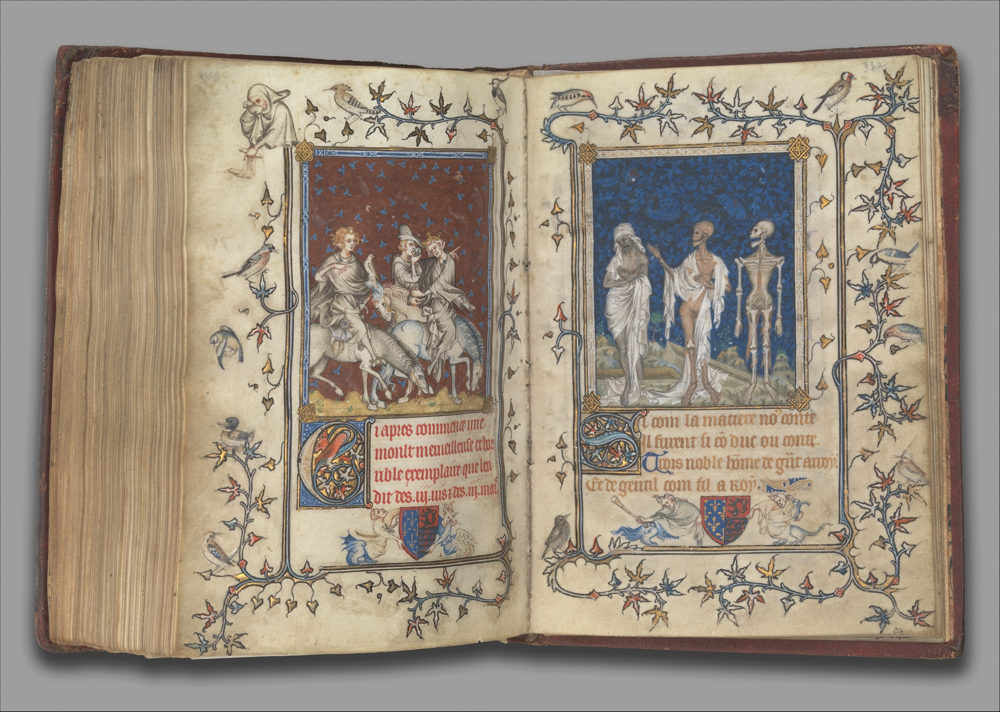

"'Umar Walks around Fulad Castle, Meets a Foot Soldier and Kicks Him to the Ground", Folio from a Hamzanama (The Adventures of Hamza) by Kesav Das, ca. 1570:

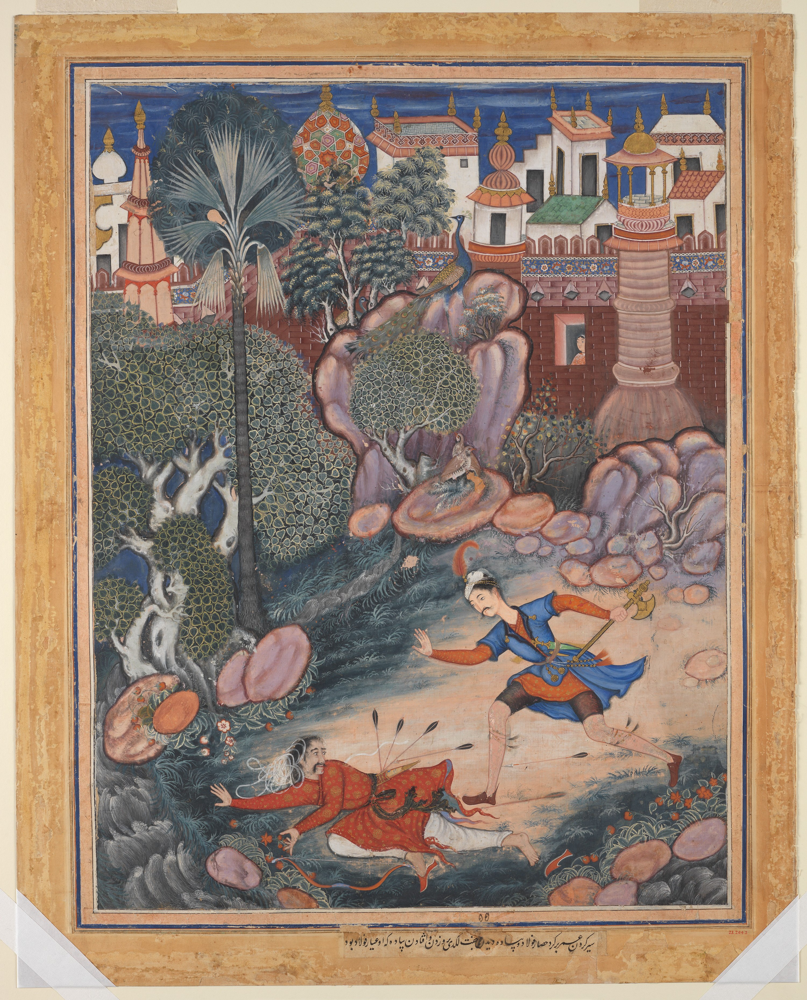

Drawing of Sasanian rock relief: Ardashir I (r. A.D. 224-241) and the Zoroastrian divinity Ahura Mazda at Naqsh-i Rustam, southern Iran by Lutf 'Ali Khan, A.D. 1860 (drawing):

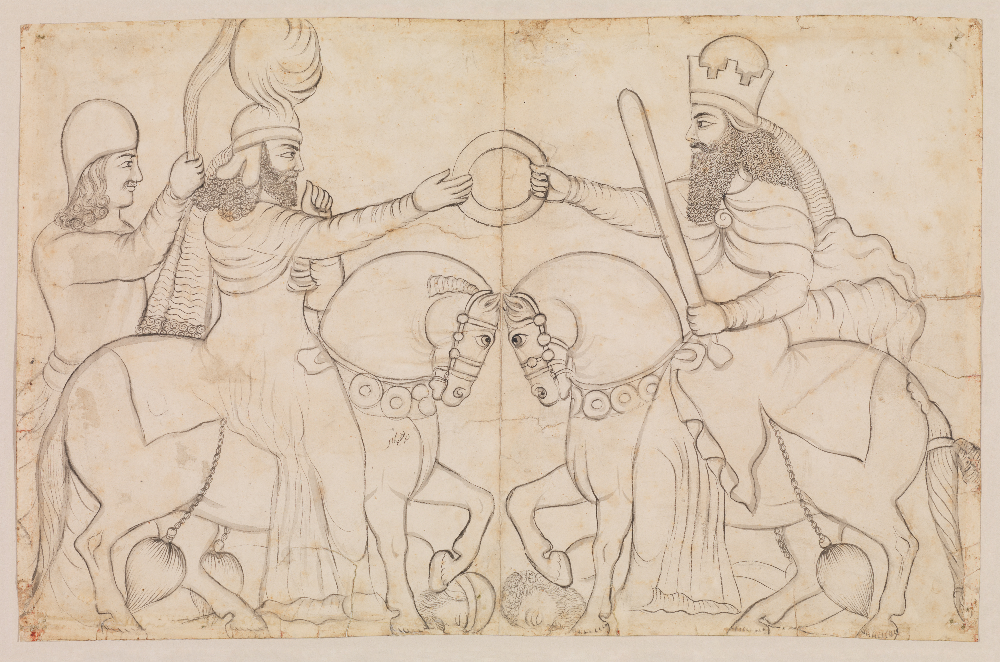

Cor solo by Jean Louis Antoine, ca. 1850–55:

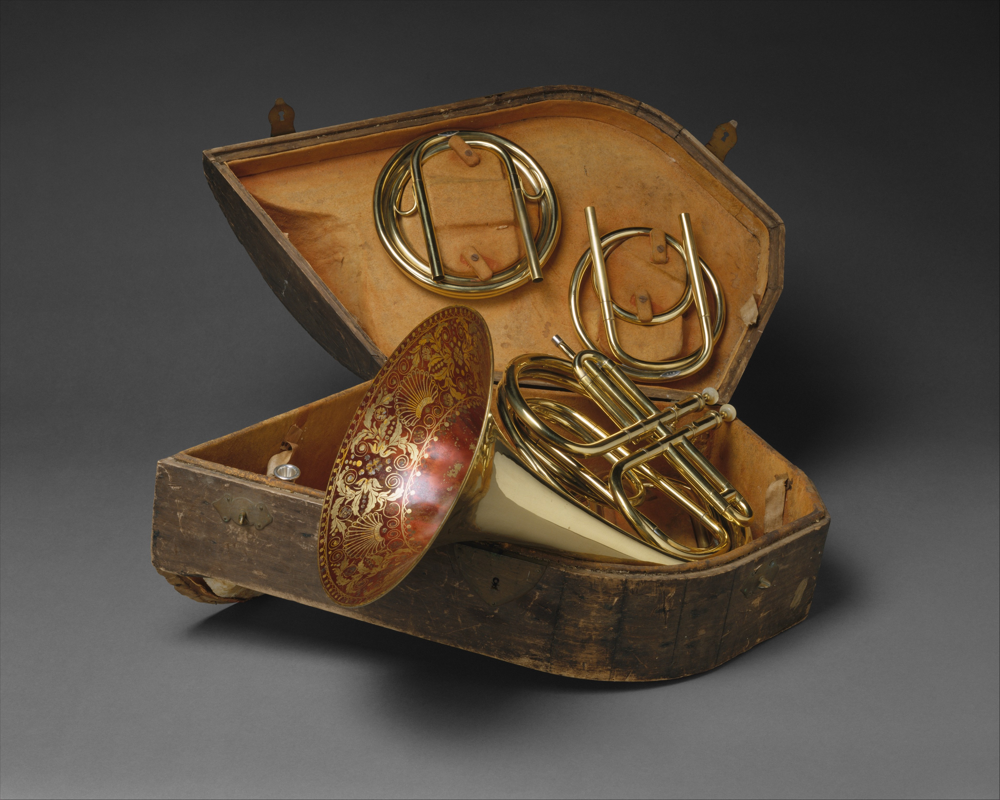

Marble statue of the Diadoumenos (youth tying a fillet around his head) by Polykleitos, 1st–2nd century A.D.:

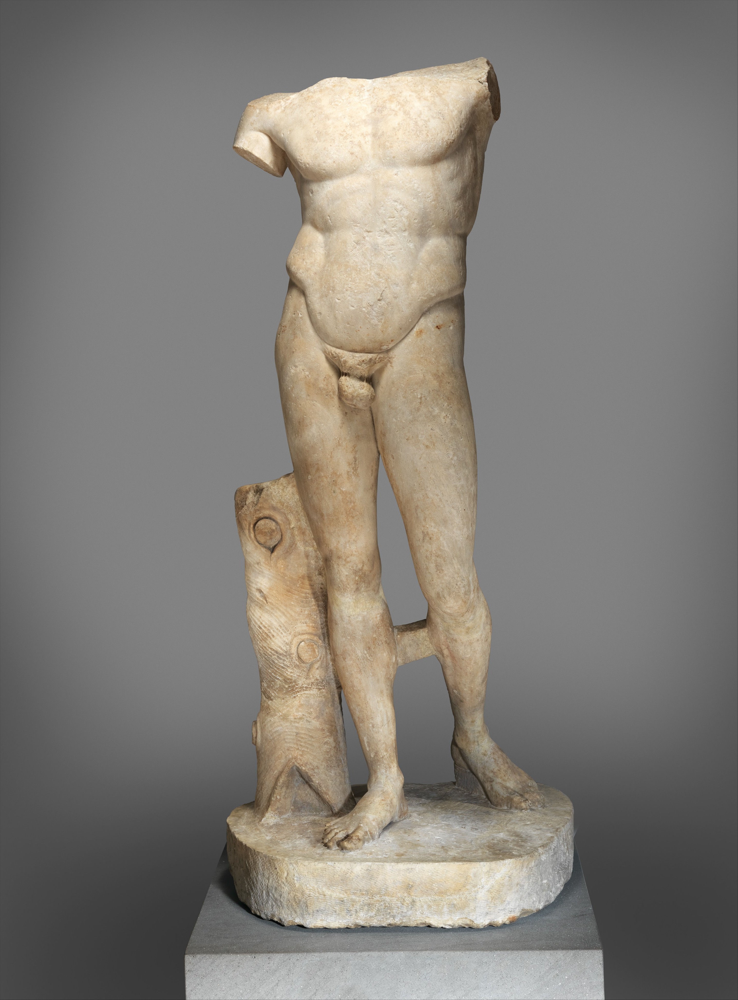

Bassoon by Frederic Triebert, 1870:

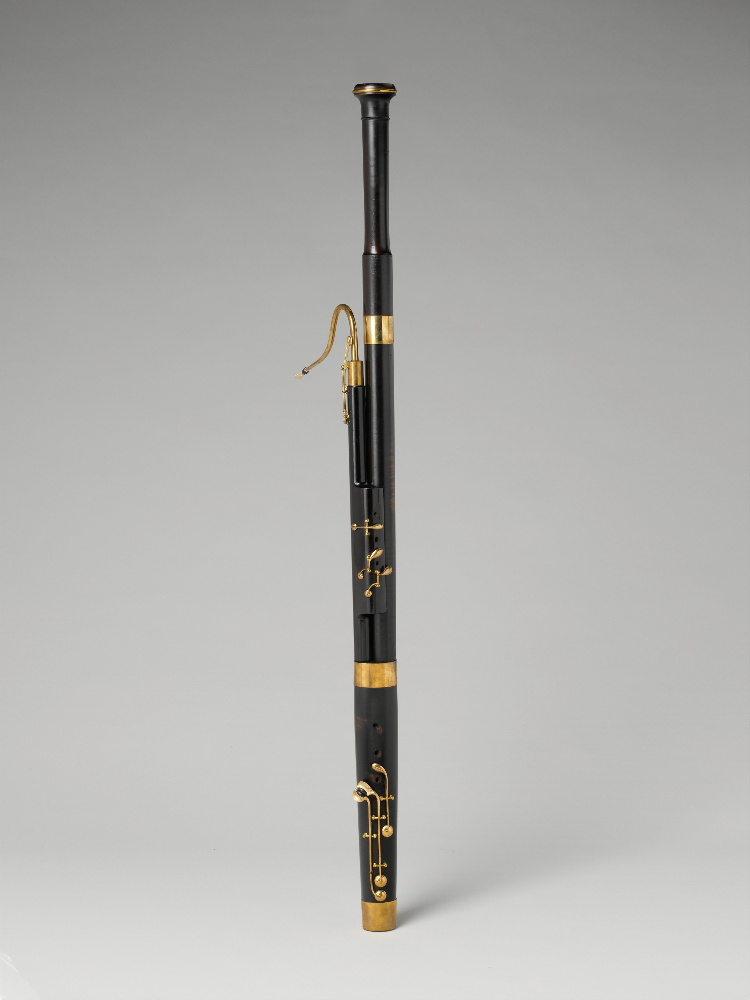

Harp String Gauge by Érard, 1829:

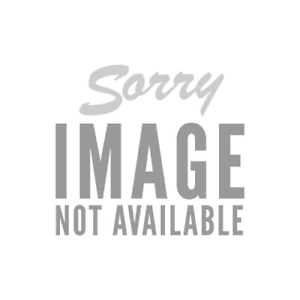

Tuba by C.W. Moritz, ca. 1855:

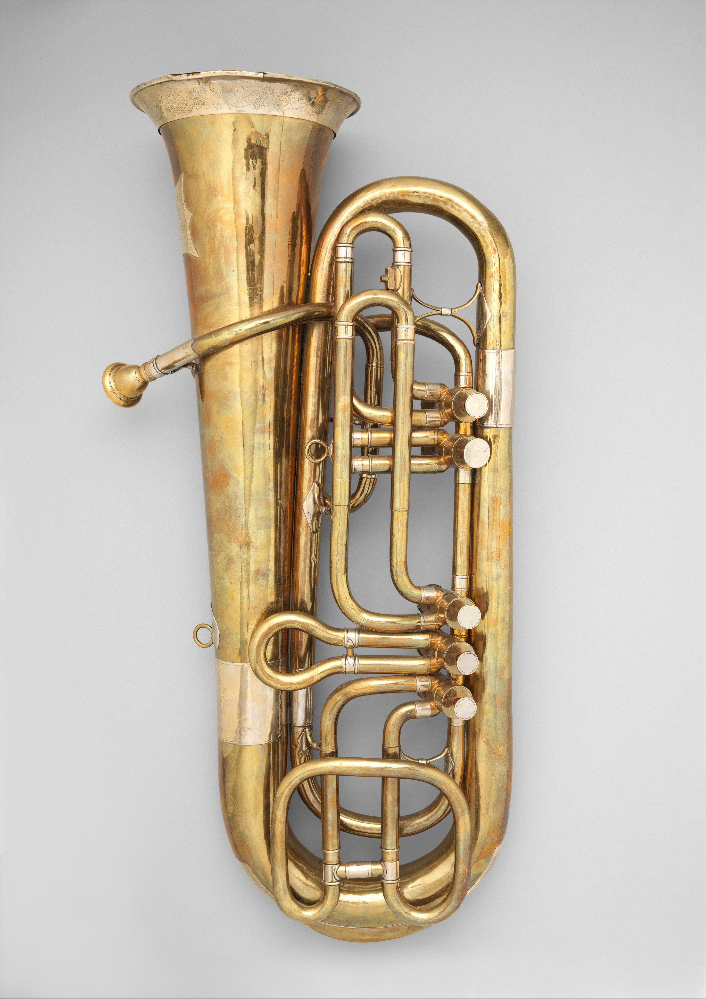

Relief of Saint Lawrence Presenting the Poor by Master of the Sonnenberg-Künigl Altar, ca. 1490:

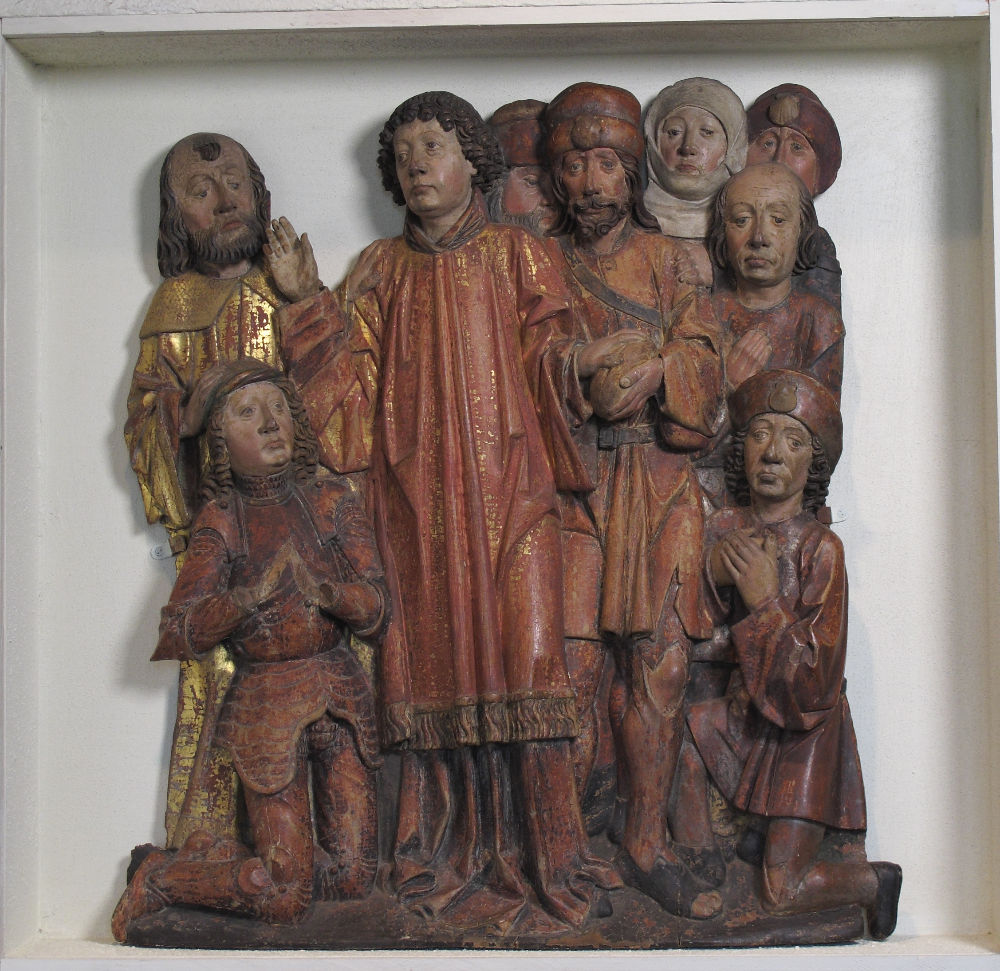

Double-Barreled Flintlock Shotgun with Exchangeable Percussion Locks and Barrels by Nicolas Noël Boutet, ca. 1818–20; exchangeable percussion locks and barrels, dated 1860:

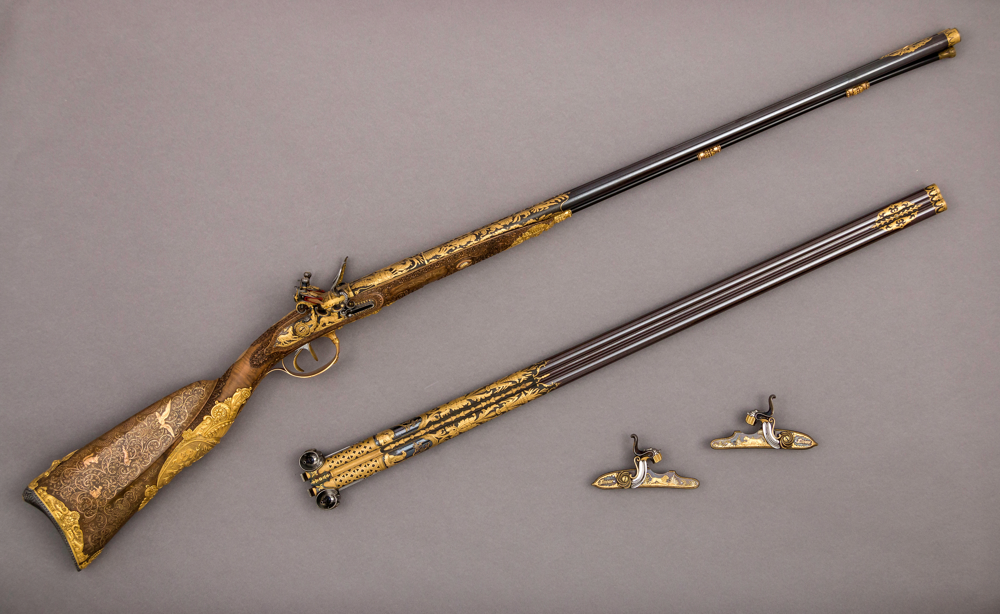

In [27]:
# Displays the pictures
Disp.display(*imgs)